In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os

sns.set_style("white")

df = pd.read_csv("EMS_CLEAN_FULL.csv")
print(df.shape)
df.head()

(219744, 8)


,IMAGE,FIX_INDEX,FIX_DURATION,FIX_X,FIX_Y,FIX_PUPIL,SUBJECT_ID,GROUP
0,outman_054.jpg,1,205,518.5,371.3,1177,0,HEALTHY
1,outman_054.jpg,2,90,275.1,282.2,1262,0,HEALTHY
2,outman_054.jpg,3,305,600.3,271.1,1265,0,HEALTHY
3,outman_054.jpg,4,269,635.2,269.2,1326,0,HEALTHY
4,outman_054.jpg,5,318,597.3,266.0,1366,0,HEALTHY


In [3]:
IMG_ROOT = "EMS/Images"

def find_image_path(filename):
    for folder in os.listdir(IMG_ROOT):
        full = os.path.join(IMG_ROOT, folder, filename)
        if os.path.exists(full):
            return full
    return None

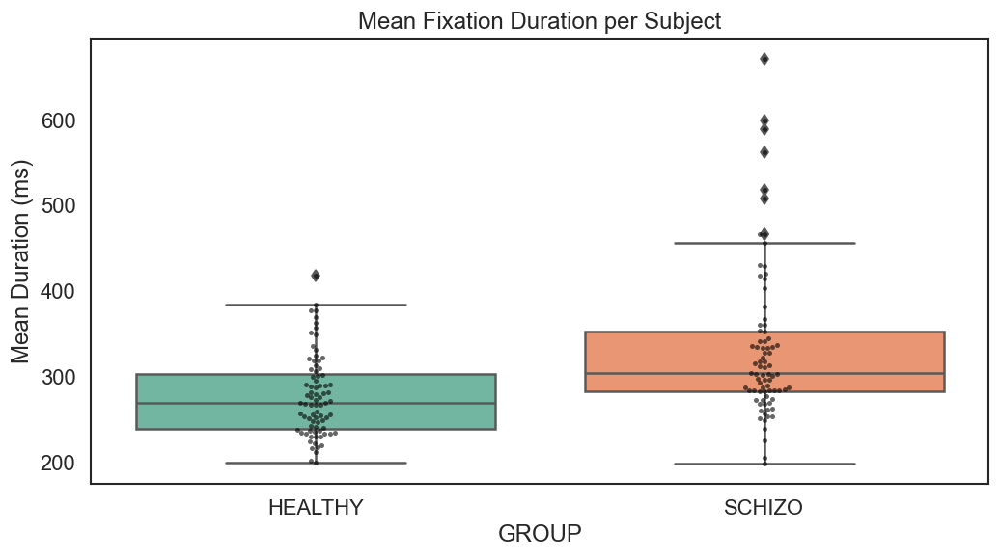

In [112]:
subject_stats = (
    df.groupby(["SUBJECT_ID", "GROUP"])
      .FIX_DURATION.mean()
      .reset_index()
)

plt.figure(figsize=(10,5))
sns.boxplot(data=subject_stats, x="GROUP", y="FIX_DURATION", palette="Set2")
sns.swarmplot(data=subject_stats, x="GROUP", y="FIX_DURATION",
              color="black", size=3, alpha=0.6)

plt.title("Mean Fixation Duration per Subject")
plt.ylabel("Mean Duration (ms)")
plt.show()

	•	Schizo có mean duration cao hơn rõ rệt.
	•	Healthy có duration ổn định hơn, variance nhỏ.

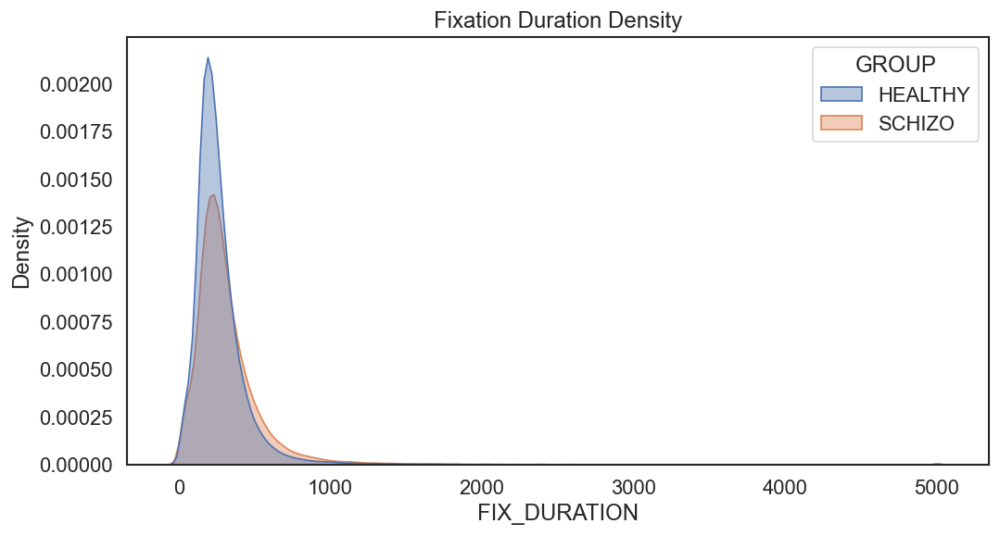

In [113]:
plt.figure(figsize=(10,5))

sns.kdeplot(data=df, x="FIX_DURATION", hue="GROUP", fill=True, alpha=0.4)
plt.title("Fixation Duration Density")
plt.show()

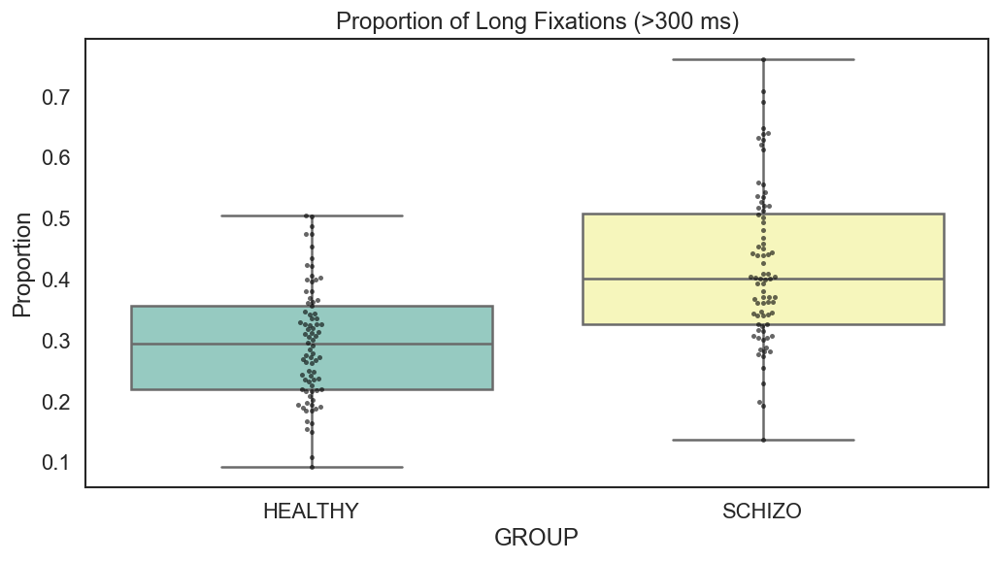

In [115]:
df["LONG_FIX"] = df.FIX_DURATION > 300

prop_long_fix = (
    df.groupby(["SUBJECT_ID","GROUP"])
      ["LONG_FIX"].mean()
      .reset_index()
)

plt.figure(figsize=(10,5))
sns.boxplot(data=prop_long_fix, x="GROUP", y="LONG_FIX", palette="Set3")
sns.swarmplot(data=prop_long_fix, x="GROUP", y="LONG_FIX",
              color="black", size=3, alpha=0.6)

plt.title("Proportion of Long Fixations (>300 ms)")
plt.ylabel("Proportion")
plt.show()

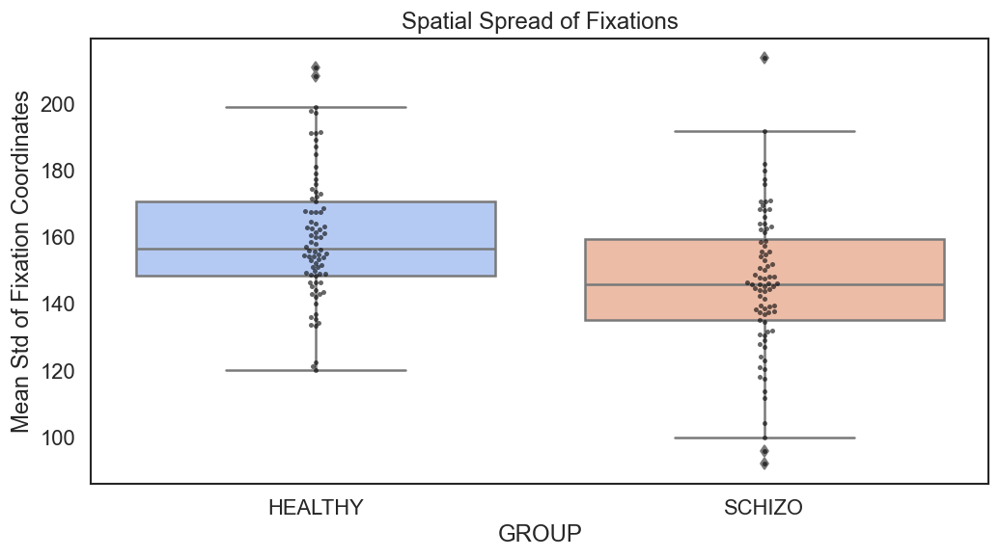

In [116]:
dispersion = (
    df.groupby(["SUBJECT_ID","GROUP"])
      .apply(lambda x: x[["FIX_X","FIX_Y"]].std().mean())
      .reset_index(name="SPATIAL_SPREAD")
)

plt.figure(figsize=(10,5))
sns.boxplot(data=dispersion, x="GROUP", y="SPATIAL_SPREAD", palette="coolwarm")
sns.swarmplot(data=dispersion, x="GROUP", y="SPATIAL_SPREAD",
              color="black", alpha=0.6, size=3)

plt.title("Spatial Spread of Fixations")
plt.ylabel("Mean Std of Fixation Coordinates")
plt.show()

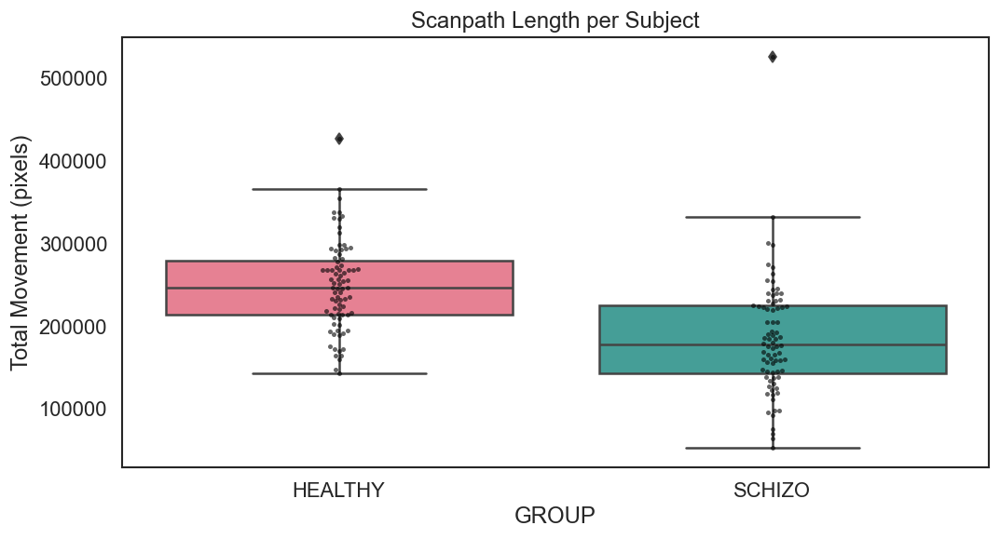

In [117]:
def scanpath_length(x):
    pts = x[["FIX_X","FIX_Y"]].values
    return np.sum(np.sqrt(np.sum(np.diff(pts, axis=0)**2, axis=1)))

scanpath = (
    df.groupby(["SUBJECT_ID","GROUP"])
      .apply(scanpath_length)
      .reset_index(name="SCANPATH_LEN")
)

plt.figure(figsize=(10,5))
sns.boxplot(data=scanpath, x="GROUP", y="SCANPATH_LEN", palette="husl")
sns.swarmplot(data=scanpath, x="GROUP", y="SCANPATH_LEN",
              color="black", alpha=0.6, size=3)

plt.title("Scanpath Length per Subject")
plt.ylabel("Total Movement (pixels)")
plt.show()

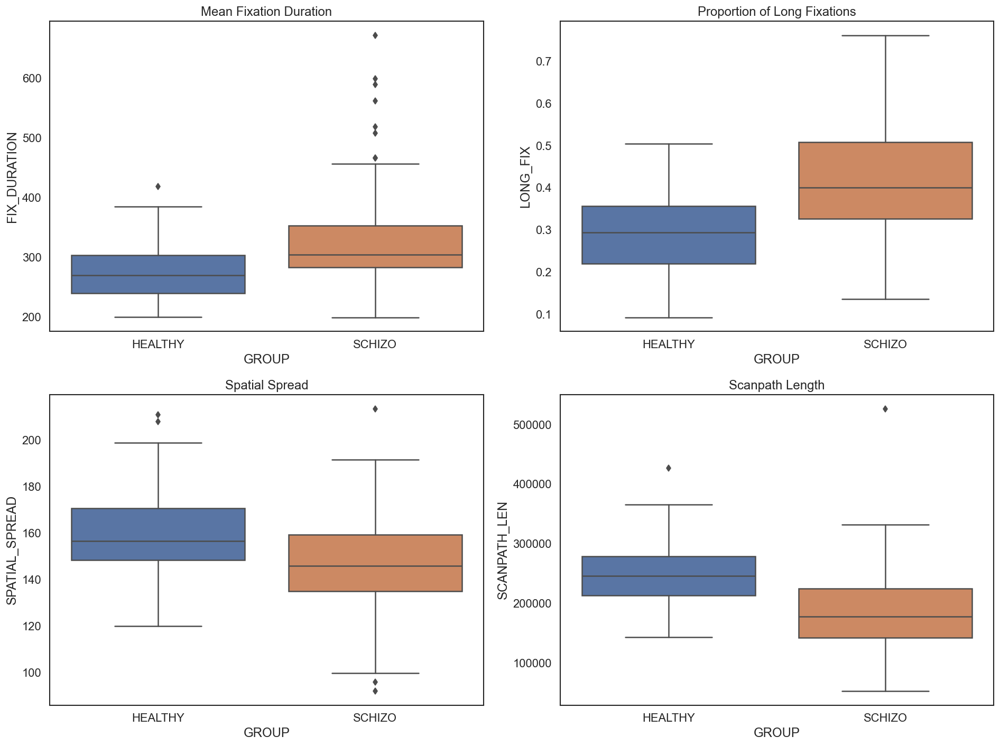

In [119]:
fig, axes = plt.subplots(2,2, figsize=(16,12))

sns.boxplot(data=subject_stats, x="GROUP", y="FIX_DURATION", ax=axes[0,0])
axes[0,0].set_title("Mean Fixation Duration")

sns.boxplot(data=prop_long_fix, x="GROUP", y="LONG_FIX", ax=axes[0,1])
axes[0,1].set_title("Proportion of Long Fixations")

sns.boxplot(data=dispersion, x="GROUP", y="SPATIAL_SPREAD", ax=axes[1,0])
axes[1,0].set_title("Spatial Spread")

sns.boxplot(data=scanpath, x="GROUP", y="SCANPATH_LEN", ax=axes[1,1])
axes[1,1].set_title("Scanpath Length")

plt.tight_layout()
plt.show()

In [179]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import gaussian_filter
import os

IMG_ROOT = "EMS/Images"

CATEGORY_PREFIX = {
    "Social Scenes": ["act","por","soc"],
    "Natural Scenes": ["ind", "land", "outman", "sat"],
    "Synthetic Images": ["art", "cat", "pat"],
    "Manipulated Images": ["low","mood","noi","patch","rand"]
}


def get_category_from_filename(filename):
    name = filename.lower()
    for cat, prefixes in CATEGORY_PREFIX.items():
        if any(name.startswith(p) for p in prefixes):
            return cat
    return None


def find_image_path(filename):
    for folder in os.listdir(IMG_ROOT):
        full = os.path.join(IMG_ROOT, folder, filename)
        if os.path.exists(full):
            return full
    return None


def create_subject_heatmap(df_subject, image_name, sigma=25):
    df_img = df_subject[df_subject["IMAGE"] == image_name]
    if df_img.empty:
        return None

    img_path = find_image_path(image_name)
    if img_path is None:
        return None

    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    h, w, _ = img.shape
    heatmap = np.zeros((h, w), dtype=np.float32)

    for _, row in df_img.iterrows():
        x = int(row["FIX_X"])
        y = int(row["FIX_Y"])
        if 0 <= x < w and 0 <= y < h:
            heatmap[y, x] += 1

    heatmap = gaussian_filter(heatmap, sigma=sigma)
    if heatmap.max() > 0:
        heatmap /= heatmap.max()

    heat_color = cv2.applyColorMap((heatmap * 255).astype(np.uint8), cv2.COLORMAP_JET)
    heat_color = cv2.cvtColor(heat_color, cv2.COLOR_BGR2RGB)

    overlay = (0.55 * heat_color + 0.45 * img).astype(np.uint8)
    return overlay


# =====================================================================
#   FIG.2 EXTENDED — MULTIPLE IMAGES PER CATEGORY
# =====================================================================

def visualize_fig2_extended(df, subject_sz, subject_hc, images_per_category=3):
    groups = {
        "SZ": subject_sz,
        "HC": subject_hc
    }

    categories = list(CATEGORY_PREFIX.keys())

    # Lấy danh sách ảnh theo category
    category_images = {cat: [] for cat in categories}

    for img in df["IMAGE"].unique():
        cat = get_category_from_filename(img)
        if cat in categories:
            category_images[cat].append(img)

    # Chỉ lấy N ảnh đầu mỗi category
    for cat in categories:
        category_images[cat] = category_images[cat][:images_per_category]

    # GRID kích thước
    total_cols = len(categories) * images_per_category
    fig, axes = plt.subplots(
        nrows=2, ncols=total_cols,
        figsize=(3.8 * total_cols, 7),  # rộng theo số ảnh
        squeeze=False
    )

    for r, (label, subject_id) in enumerate(groups.items()):
        df_sub = df[df["SUBJECT_ID"] == subject_id]

        col_index = 0
        for cat in categories:
            imgs = category_images[cat]

            for img_name in imgs:
                ax = axes[r, col_index]
                overlay = create_subject_heatmap(df_sub, img_name)

                if overlay is None:
                    ax.axis("off")
                else:
                    ax.imshow(overlay)
                    if r == 0:  # Hàng SZ → ghi tên category
                        ax.set_title(f"{label} — {cat}", fontsize=12)
                    else:
                        ax.set_title(f"{label} — {cat}", fontsize=12)

                    ax.axis("off")

                col_index += 1

    plt.tight_layout()
    plt.savefig("FIG2_EXTENDED_MULTI_IMAGE.png", dpi=300)
    plt.show()

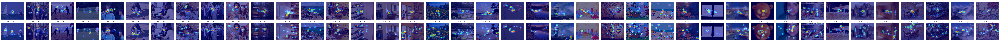

In [181]:
sz_id = df[df["GROUP"]=="SCHIZO"]["SUBJECT_ID"].unique()[0]
hc_id = df[df["GROUP"]=="HEALTHY"]["SUBJECT_ID"].unique()[0]

visualize_fig2_extended(df, sz_id, hc_id, images_per_category=10)